In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [3]:
import numpy as np
import torch
import scanpy as sc
import muon as mu
import anndata
import mudata
import pandas as pd

print(anndata.__version__)
print(mudata.__version__)
print(sc.__version__)
print(torch.__version__)

0.8.0
0.2.1
1.9.2
1.11.0


In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
torch.manual_seed(2137)
np.random.seed(2137)

In [6]:
mdata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_preprocessed_final_filtered.h5mu')

In [8]:
adata = mdata.mod["rna"]
sc.pp.normalize_total(adata, target_sum=1e4)

In [9]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="clusters")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


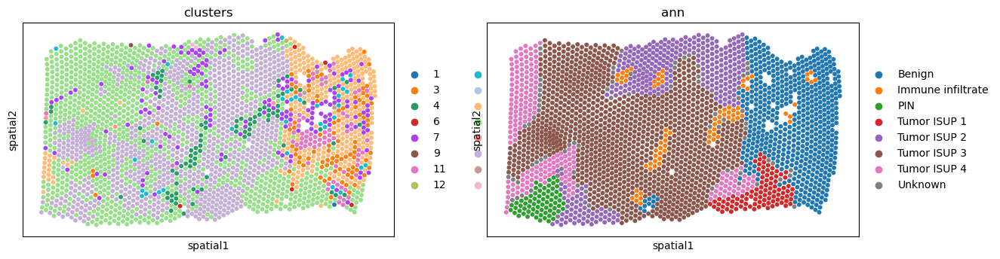

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


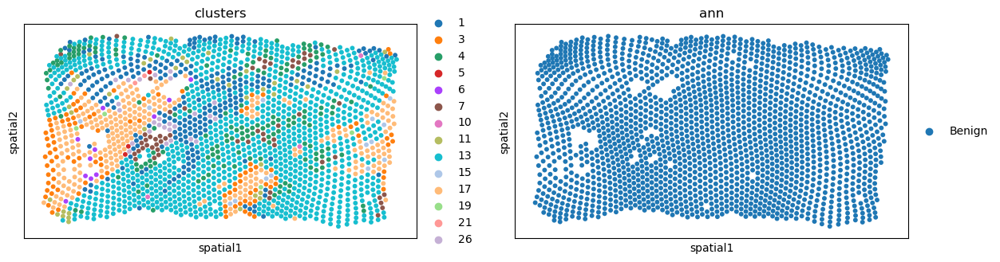

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


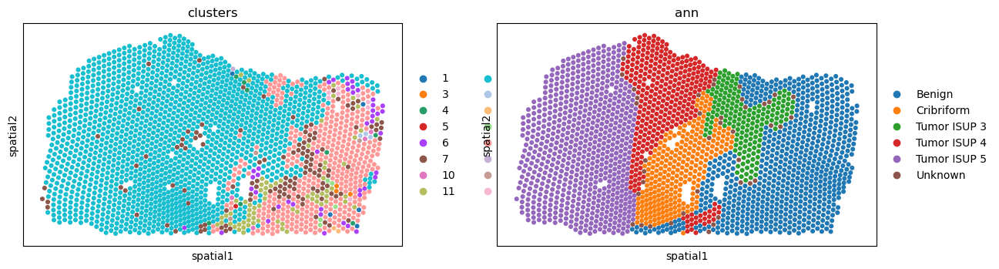

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


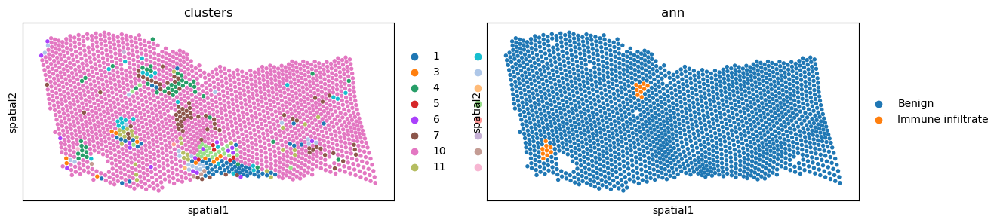

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


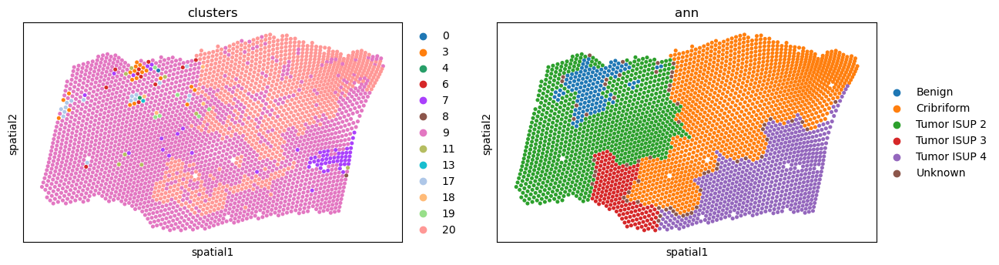

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


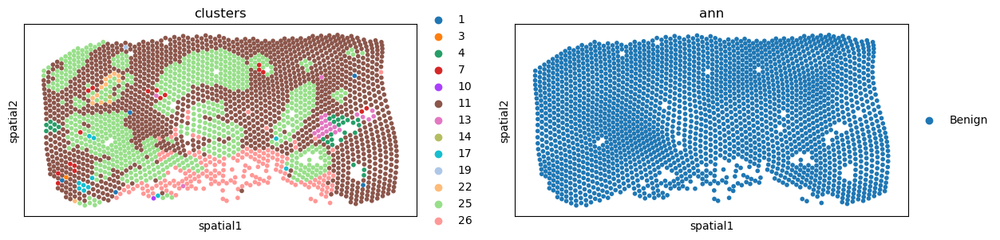

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


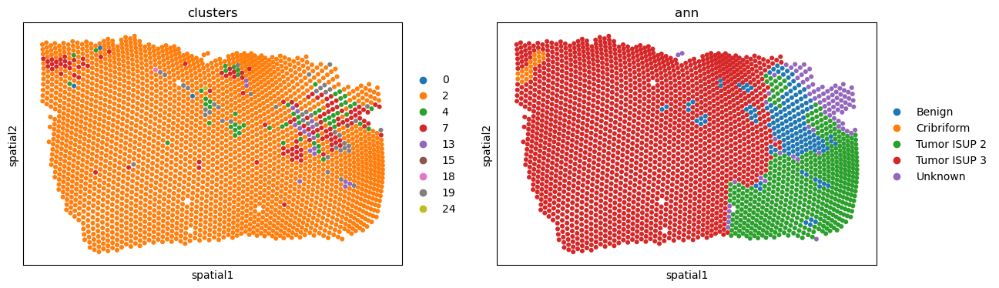

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


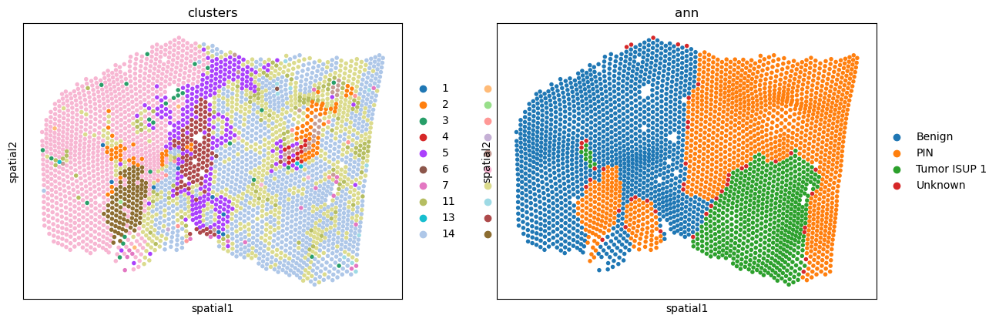

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


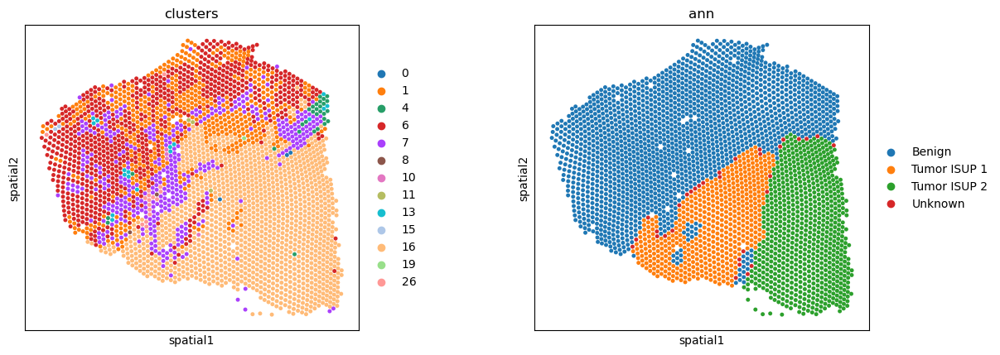

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


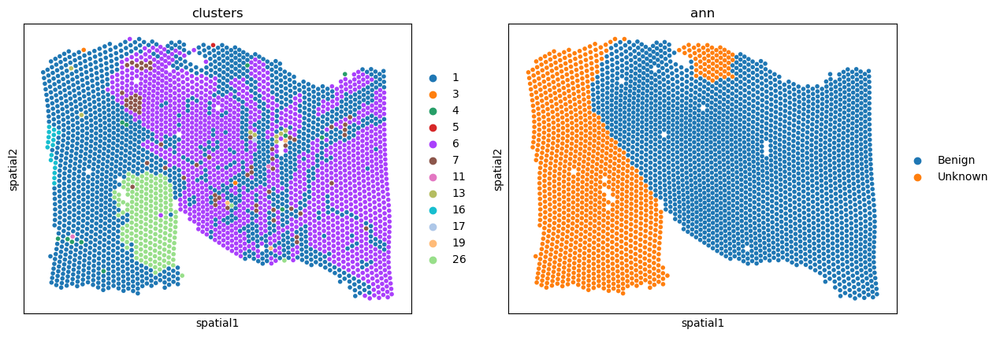

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


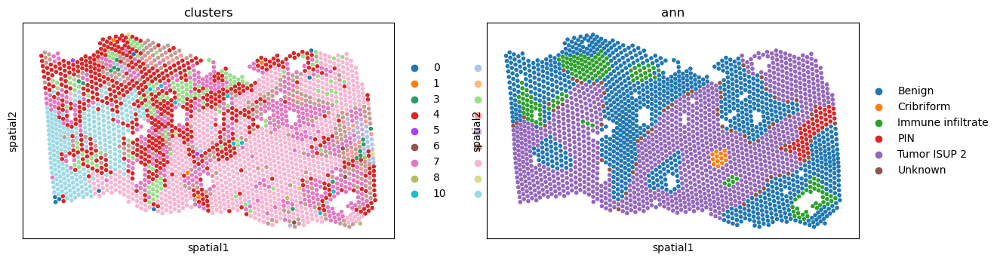

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


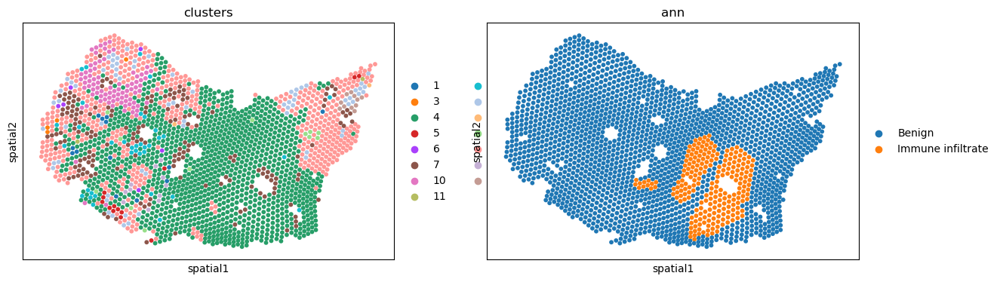

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


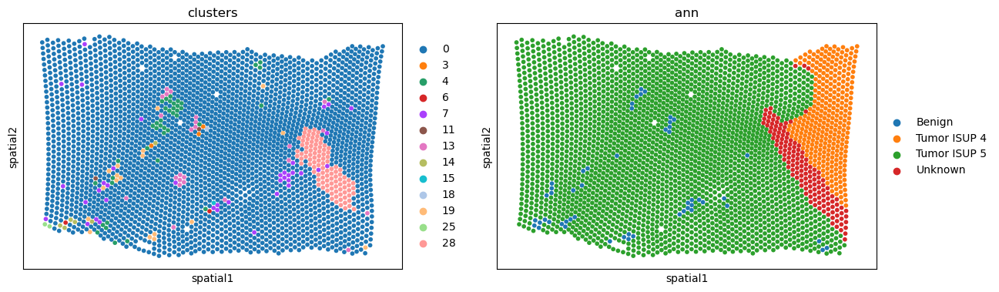

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


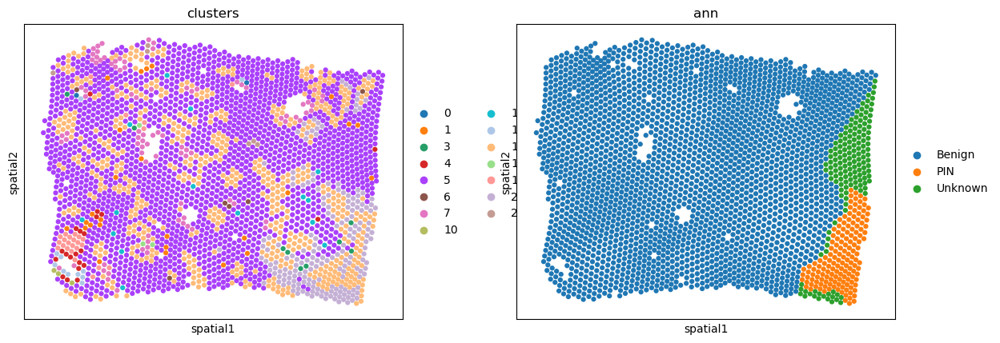

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


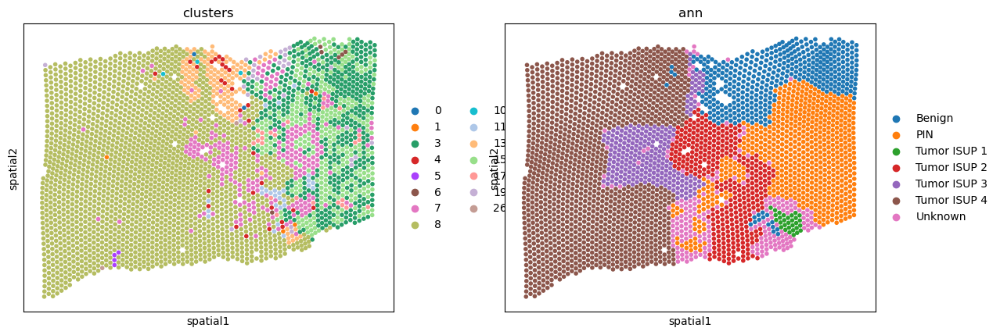

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


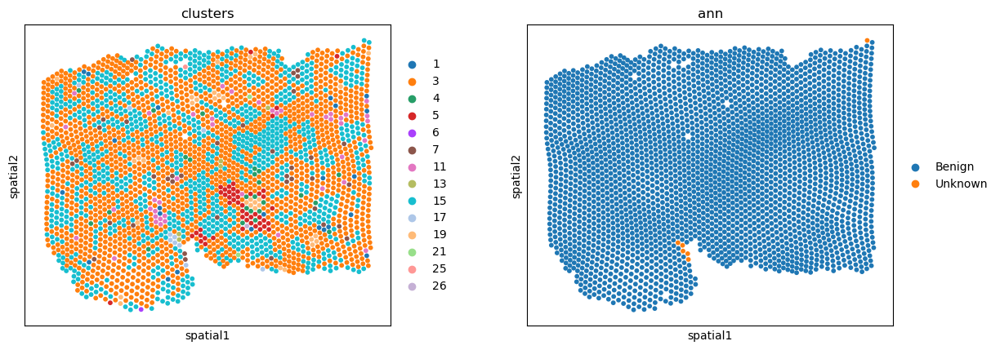

In [40]:
for s in adata.obs.loc[:,'sample'].unique():
    adata_sample = adata[adata.obs.loc[:,'sample']==s]
    sc.pl.spatial(adata_sample, spot_size=3, color=["clusters", "ann"]) 

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


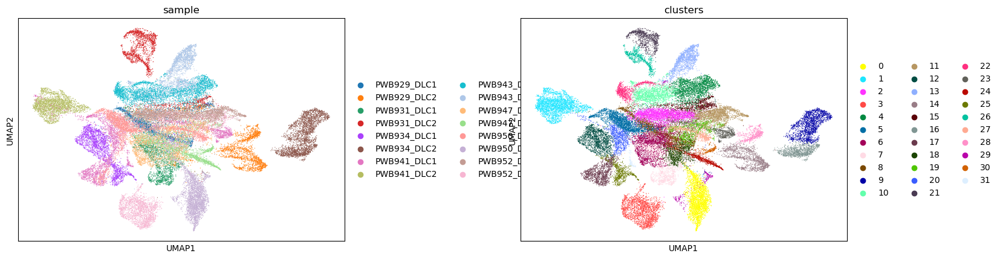

In [49]:
sc.pl.umap(adata, color=["sample", "clusters"], wspace=0.4)

## Harmony

In [50]:
import scanpy.external as sce
sce.pp.harmony_integrate(adata, 'sample')

2023-04-20 14:19:24,673 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-04-20 14:19:32,798 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-04-20 14:19:32,915 - harmonypy - INFO - Iteration 1 of 10
2023-04-20 14:19:42,150 - harmonypy - INFO - Iteration 2 of 10
2023-04-20 14:19:51,633 - harmonypy - INFO - Iteration 3 of 10
2023-04-20 14:20:00,824 - harmonypy - INFO - Iteration 4 of 10
2023-04-20 14:20:09,967 - harmonypy - INFO - Iteration 5 of 10
2023-04-20 14:20:19,183 - harmonypy - INFO - Converged after 5 iterations


/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


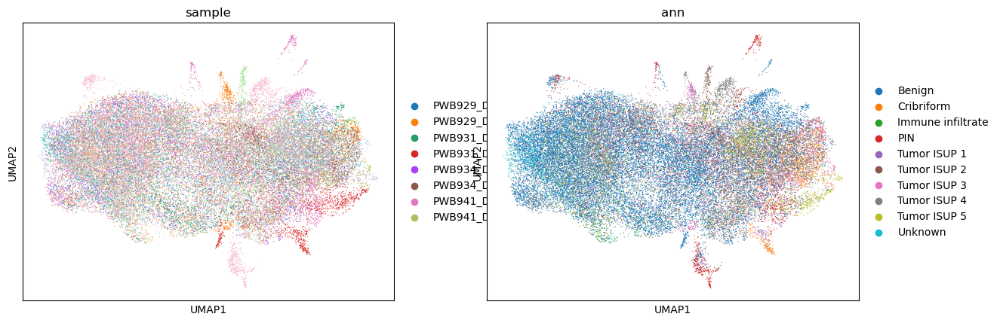

In [51]:
sc.pp.neighbors(adata, use_rep="X_pca_harmony", n_neighbors=30)
sc.tl.umap(adata)
sc.pl.umap(
    adata,
    color=["sample", "ann"],
)

In [45]:
sc.tl.leiden(adata, key_added="clusters_harmony")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


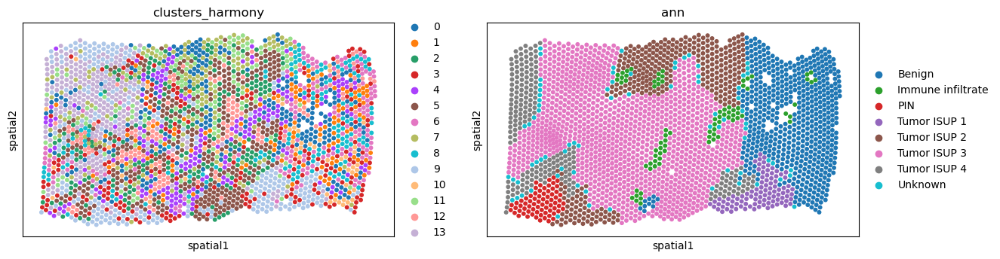

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


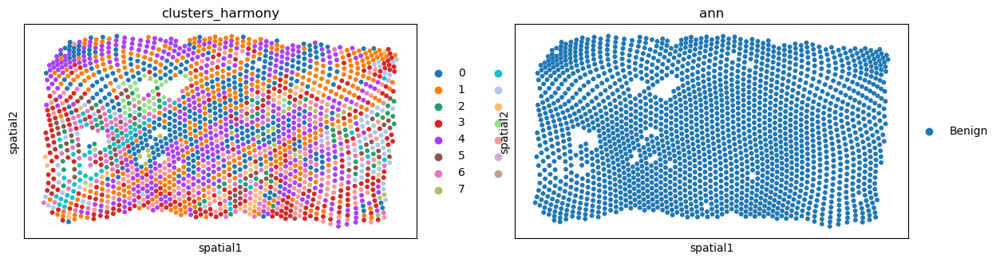

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


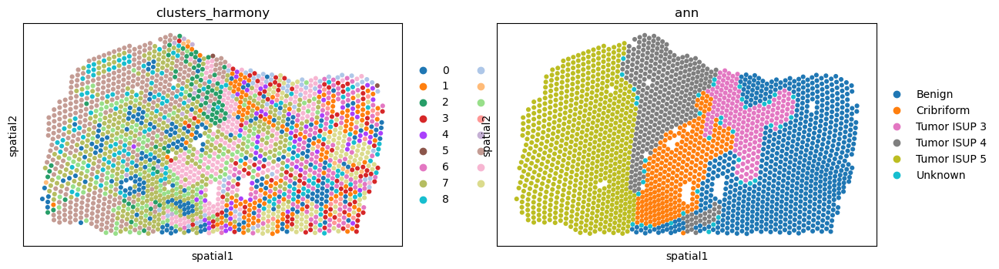

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


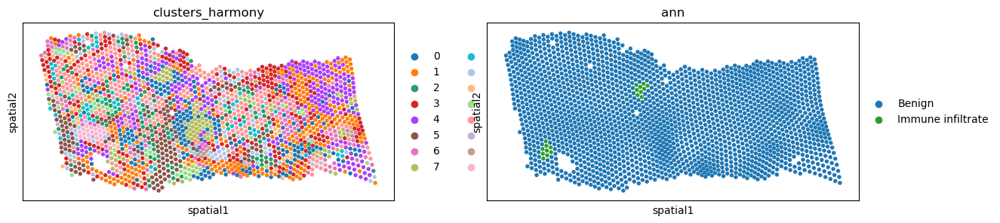

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


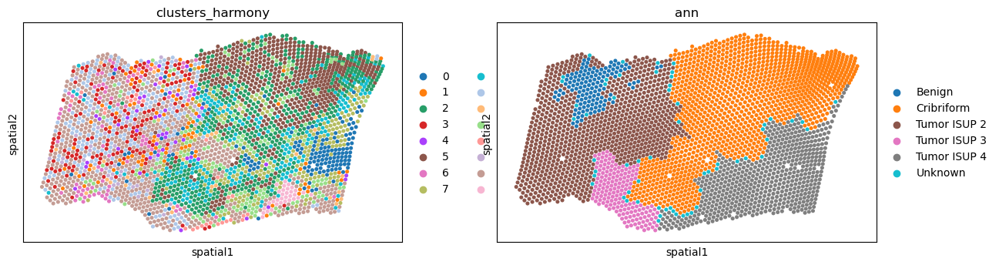

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


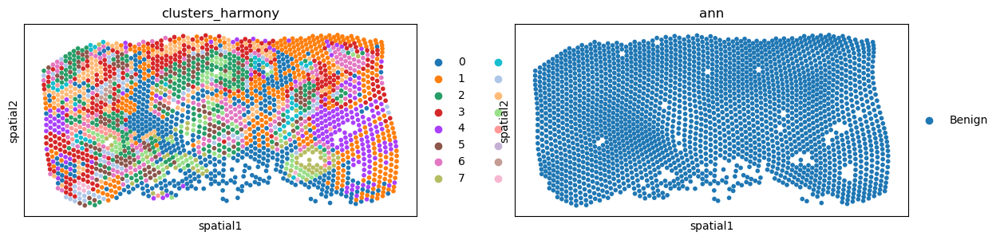

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


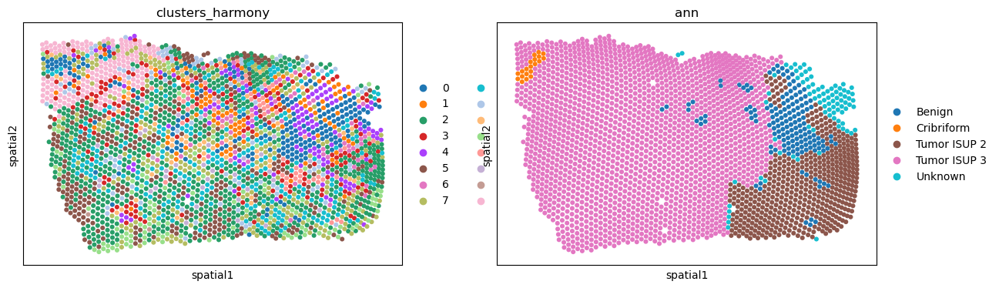

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


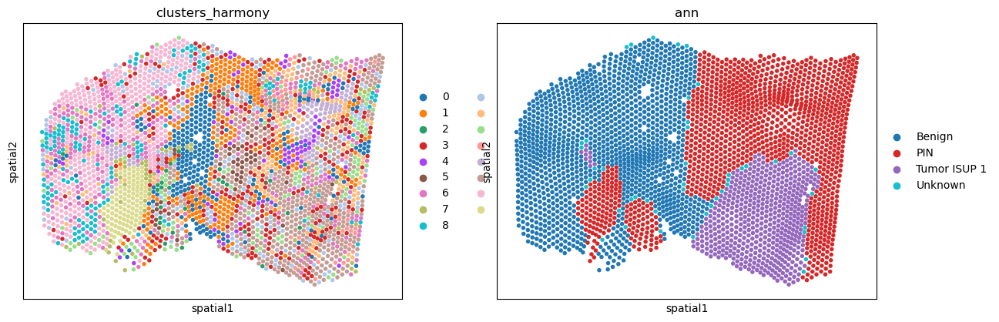

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


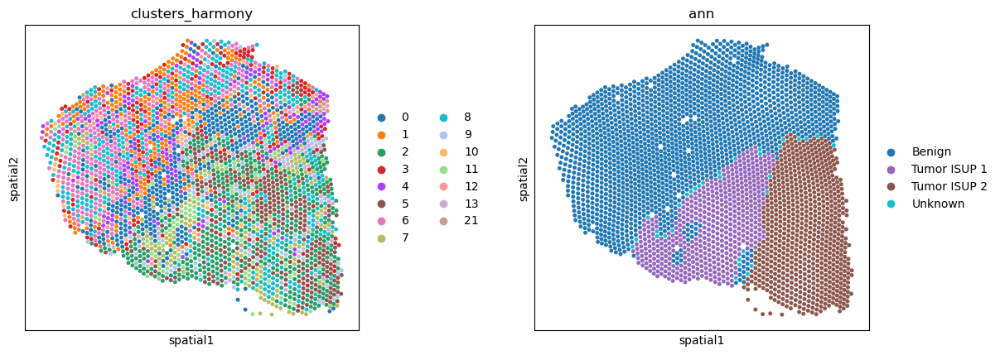

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


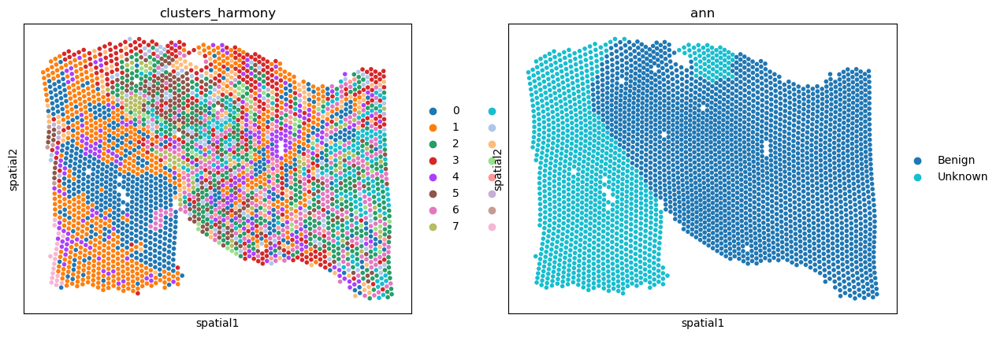

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


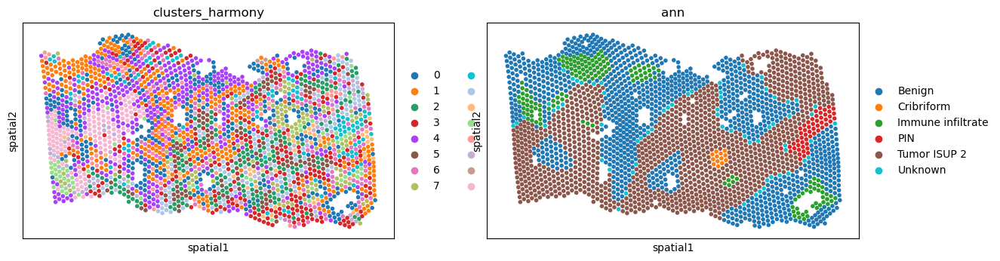

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


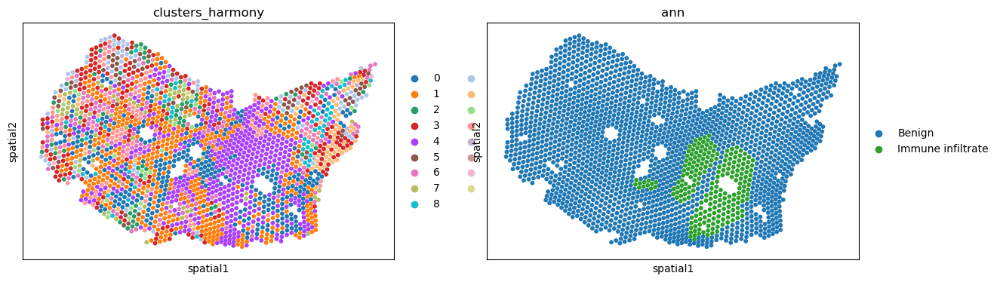

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


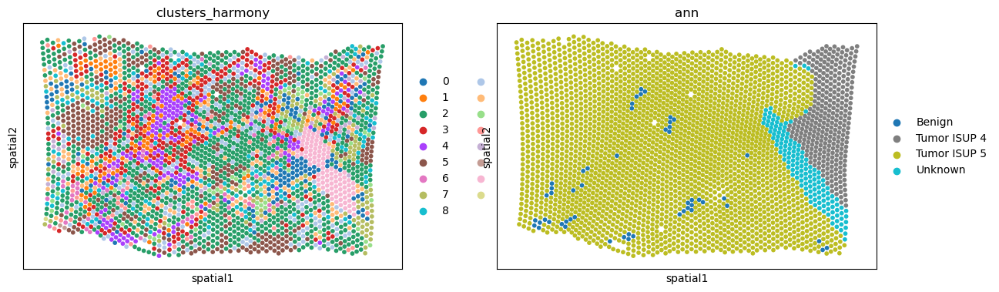

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


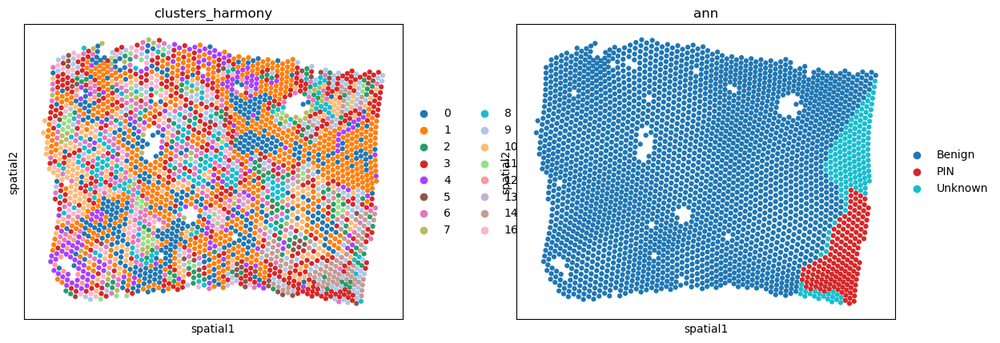

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


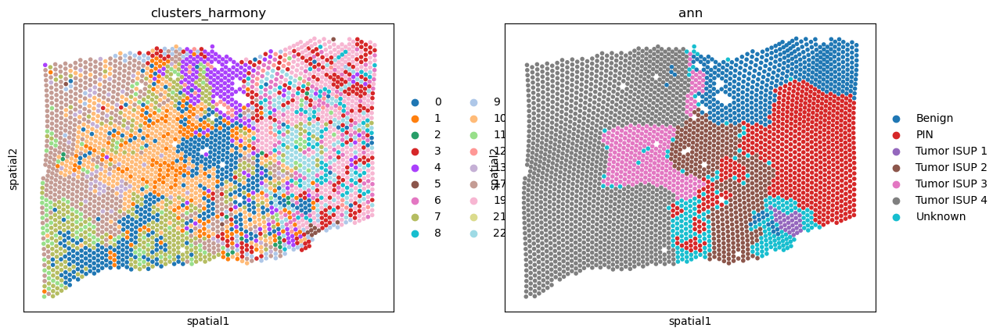

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


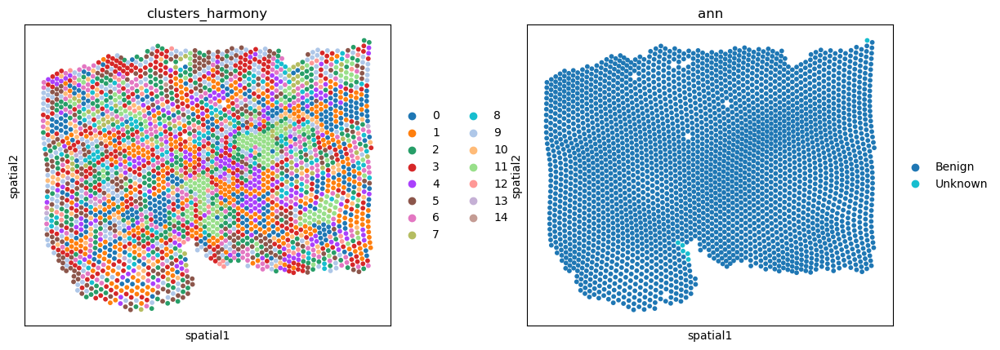

In [46]:
for s in adata.obs.loc[:,'sample'].unique():
    adata_sample = adata[adata.obs.loc[:,'sample']==s]
    sc.pl.spatial(adata_sample, spot_size=3, color=["clusters_harmony", "ann"]) 

## VAE

In [52]:
from src.types import TrainParams
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate_0.5priv")

In [53]:
from src.vae.model import VAE, ModelParams

model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

In [55]:
# from src.vae.train import train_vae
# hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)

model.load_state_dict(torch.load("mvae_params/prostate_0.5priv_20230420-142203.pt"))

<All keys matched successfully>

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:20<00:00, 16.29it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


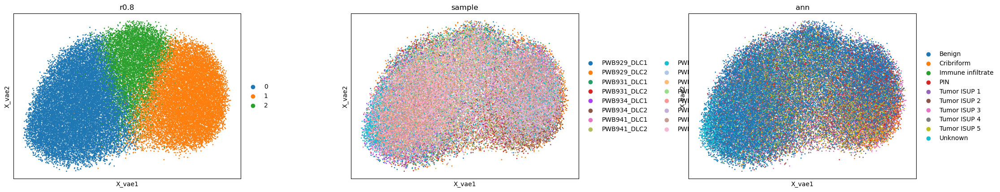

In [56]:
from src.vae.diagnostics import plot_embedding

plot_embedding(model, adata, keys=["sample", "ann"], batch_keys=["sample"], train_params=train_params)

In [57]:
sc.tl.leiden(adata, key_added="clusters_vae")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


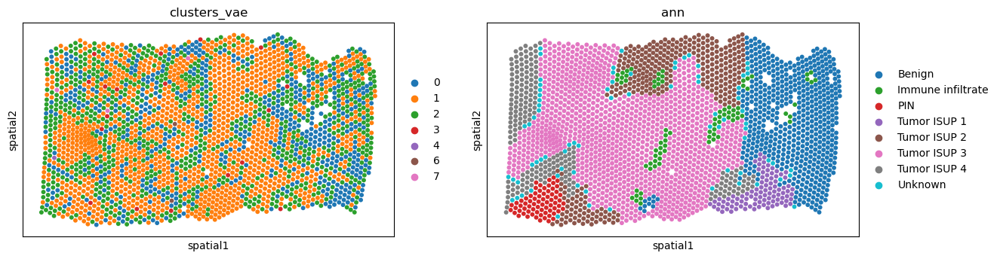

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


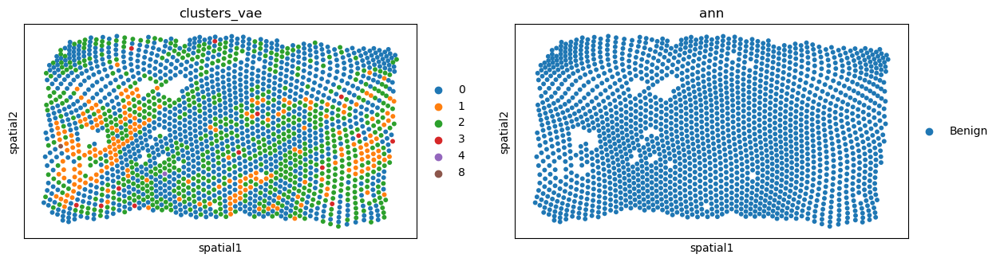

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


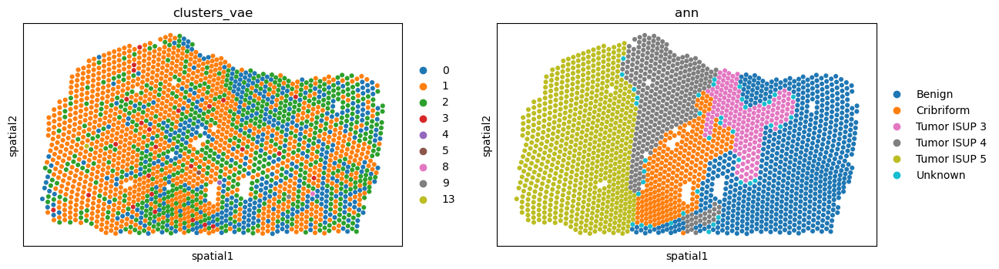

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


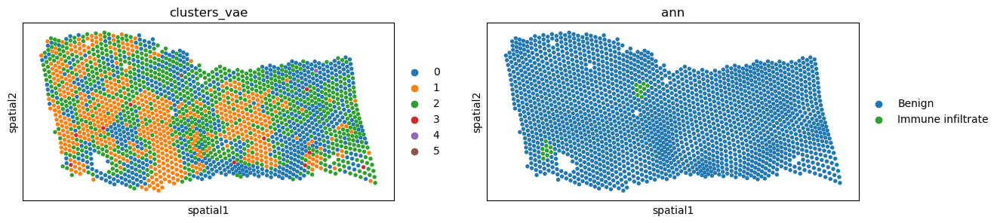

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


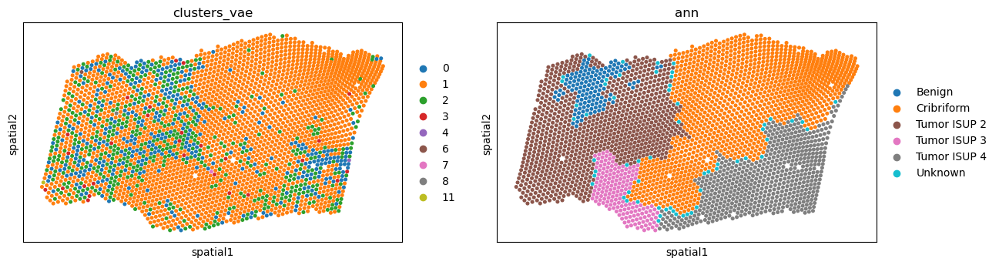

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


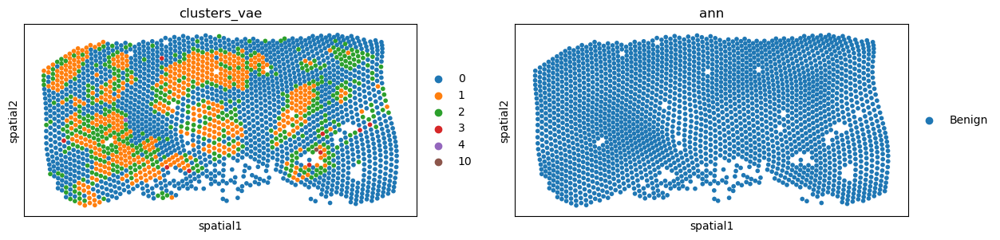

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


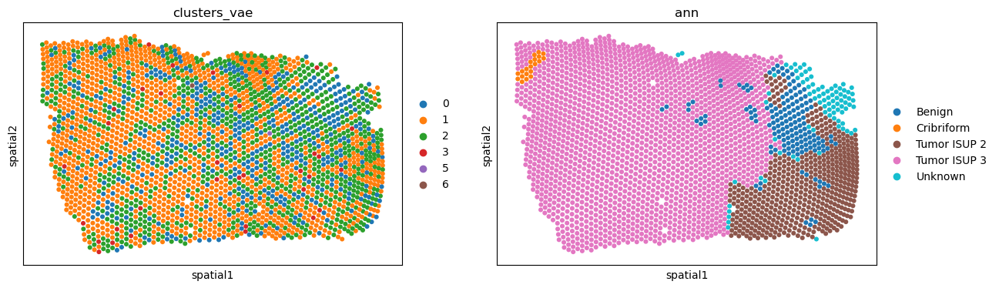

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


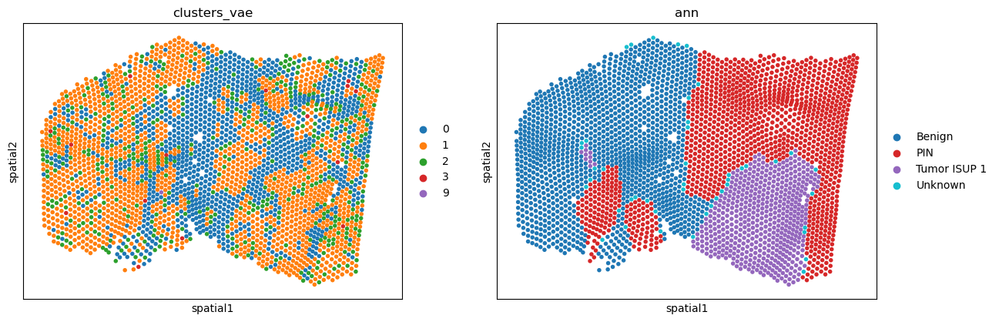

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


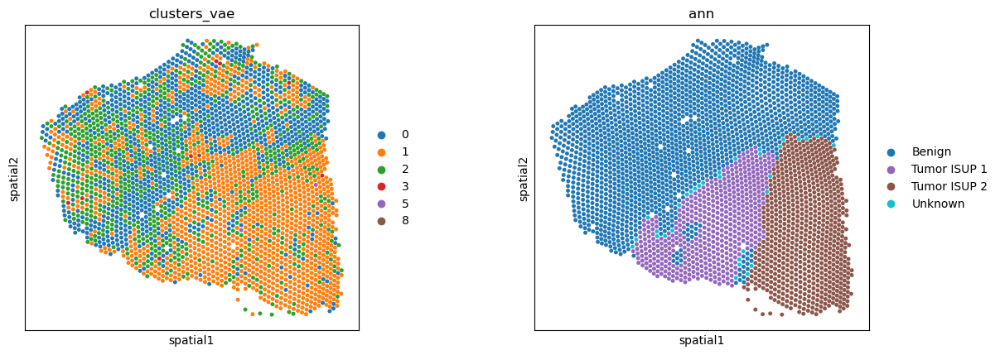

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


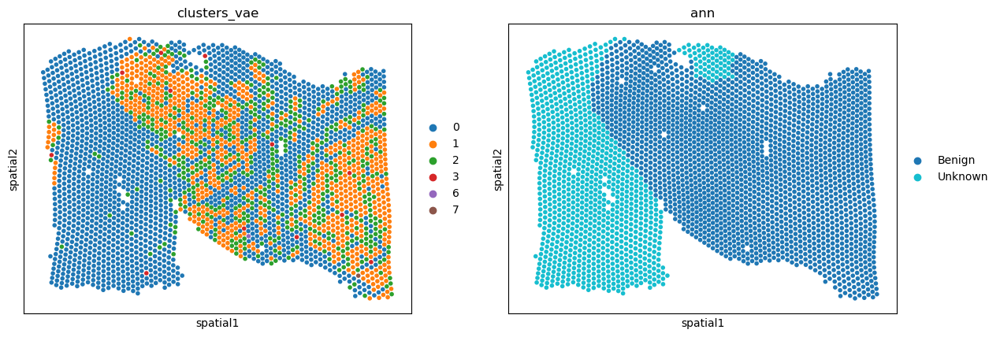

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


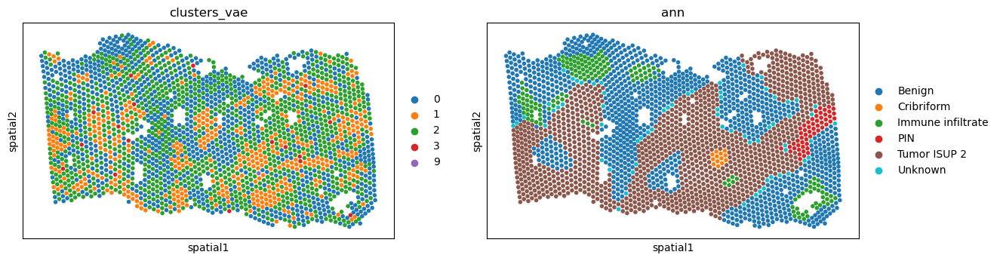

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


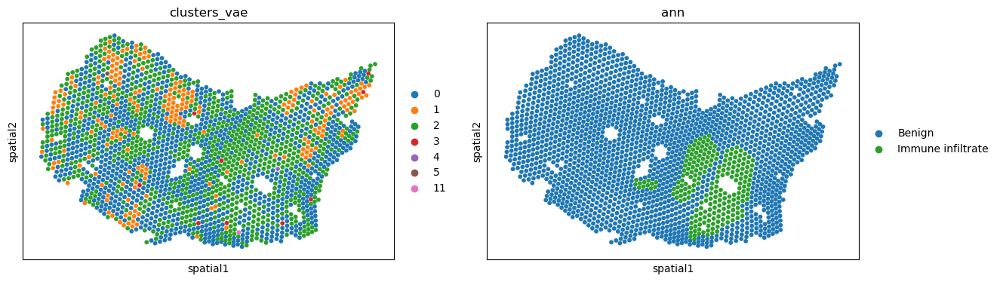

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


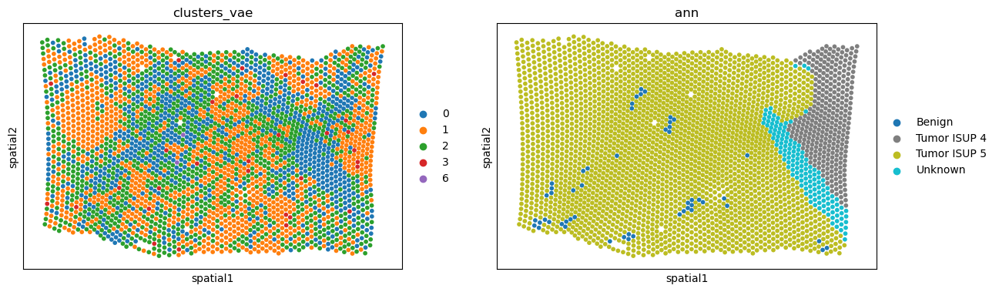

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


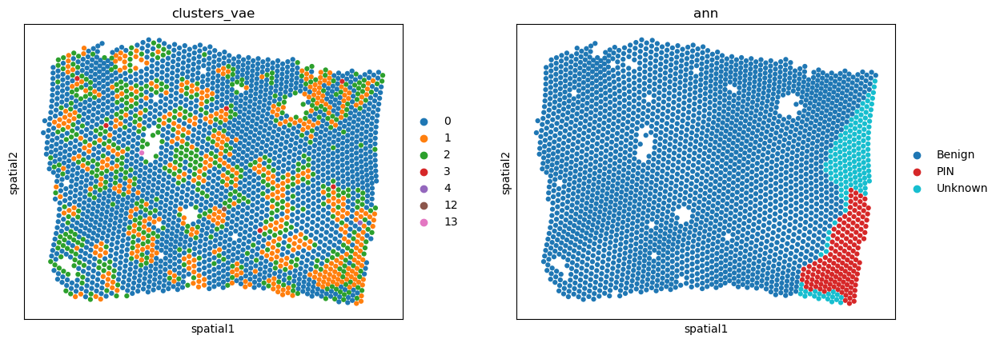

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


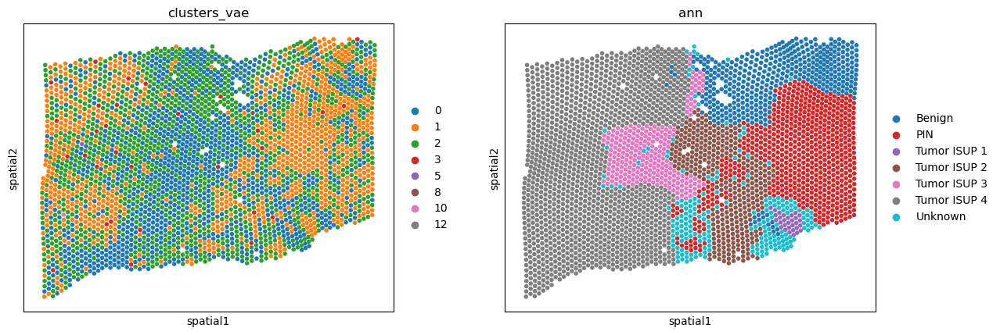

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


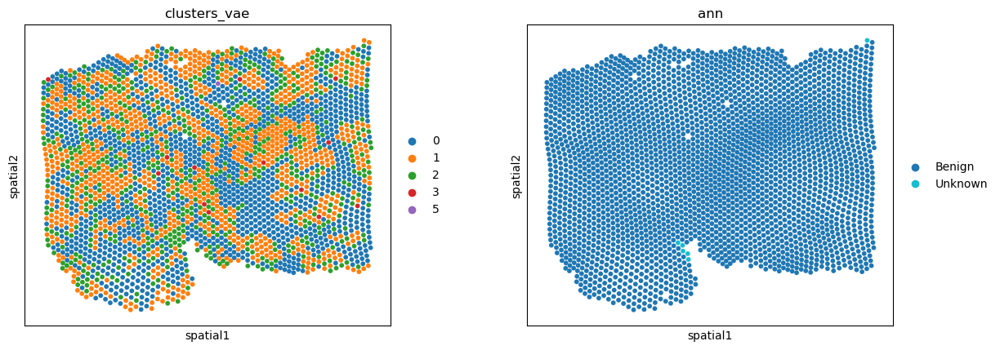

In [58]:
for s in adata.obs.loc[:,'sample'].unique():
    adata_sample = adata[adata.obs.loc[:,'sample']==s]
    sc.pl.spatial(adata_sample, spot_size=3, color=["clusters_vae", "ann"]) 

VAE loss = MSE + gamma * LISI(sample), where gamma = 0.3 MSE / LISI

In [65]:
from src.types import TrainParams
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate_0.3priv")

In [66]:
from src.vae.model import VAE, ModelParams

model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

In [68]:
# from src.vae.train import train_vae
# hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)
model.load_state_dict(torch.load("mvae_params/prostate_0.3priv_20230420-163111.pt"))

<All keys matched successfully>

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:25<00:00, 13.13it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


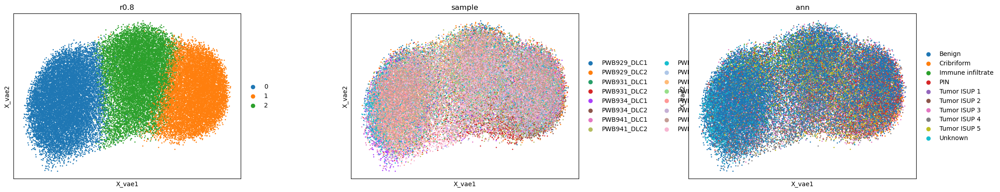

In [69]:
plot_embedding(model, adata, keys=["sample", "ann"], batch_keys=["sample"], train_params=train_params)

In [74]:
from src.types import TrainParams
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate_0.05priv")

In [75]:
from src.vae.model import VAE, ModelParams

model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

In [76]:
from src.vae.train import train_vae
hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)

100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:27<00:00,  1.80it/s]

EarlyStopping (epoch: 1): train loss improved to 0.040571355574126805



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.93it/s]

EarlyStopping (epoch: 1): valid loss improved to 4.772303944203391



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.93it/s]

EarlyStopping (epoch: 2): valid loss improved to 3.3215155850595504



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.92it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.9689022320419993



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:35<00:00,  1.91it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.899086777843646



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.95it/s]

EarlyStopping (epoch: 5): valid loss improved to 2.888170352622644



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.93it/s]

EarlyStopping (epoch: 7): valid loss improved to 2.852191350353298



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.92it/s]

EarlyStopping (epoch: 9): valid loss improved to 2.8349292705308144



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.93it/s]

EarlyStopping (epoch: 10): valid loss improved to 2.820489929683173



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:34<00:00,  1.92it/s]

EarlyStopping (epoch: 11): valid loss improved to 2.806022789940905



 80%|████████████████████████████████████████████████████████▎             | 214/266 [02:00<00:27,  1.86it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:25<00:00, 13.17it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


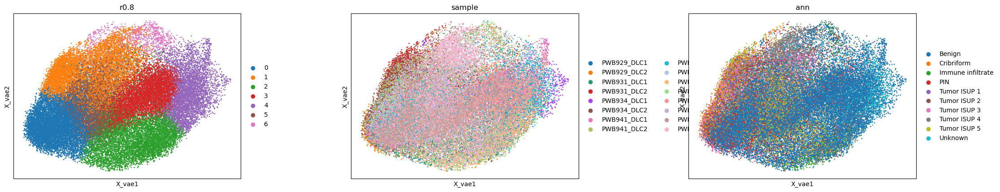

In [77]:
plot_embedding(model, adata, keys=["sample", "ann"], batch_keys=["sample"], train_params=train_params)

In [78]:
from src.types import TrainParams
train_params = TrainParams(add_lisi_loss=False, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate_no_lisi")

In [79]:
from src.vae.model import VAE, ModelParams

model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

In [80]:
from src.vae.train import train_vae
hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)

100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.37it/s]

EarlyStopping (epoch: 1): train loss improved to 0.03734194487245592



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.62it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.4318624361237484



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:26<00:00, 10.12it/s]

EarlyStopping (epoch: 2): train loss improved to 0.022285173541310956



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.53it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.5915127298725187



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:09<00:00,  6.73it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.540264019325598



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.69it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.5175392520961477



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.67it/s]

EarlyStopping (epoch: 5): valid loss improved to 2.5050458054044356



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.67it/s]

EarlyStopping (epoch: 6): valid loss improved to 2.473733385997032



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.62it/s]

EarlyStopping (epoch: 7): valid loss improved to 2.4620068215612156



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.53it/s]

EarlyStopping (epoch: 8): valid loss improved to 2.4451353941390765



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:09<00:00,  6.74it/s]

EarlyStopping (epoch: 9): valid loss improved to 2.4177298261158504



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.54it/s]

EarlyStopping (epoch: 11): valid loss improved to 2.3892077154188014



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.58it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.01862820463014954. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.38it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.01854477416353411. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.58it/s]

EarlyStopping (epoch: 13): valid loss improved to 2.376609638555726



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.58it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.018482543136036488. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.41it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.01843101185444455. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.63it/s]

EarlyStopping (epoch: 15): valid loss improved to 2.3517893321478547



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.54it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.018396983457495703. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.56it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.018350801954134695. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:24<00:00, 10.78it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.018328109336222108. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:24<00:00, 10.70it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.018309393930322916. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.54it/s]

EarlyStopping (epoch: 19): valid loss improved to 2.336926999376781



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.60it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.018266664981280725. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.37it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.018243092266933717. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:26<00:00, 10.17it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.018231142889828876. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.55it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.018209352515738735. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.59it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.018190680717004616. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.51it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.0181811365223829. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:09<00:00,  6.74it/s]

EarlyStopping (epoch: 25): valid loss improved to 2.325573428353267



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.50it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.018177025338493424. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.33it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.018156527308171605. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:24<00:00, 10.74it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.018149077432726746. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.40it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.018140851746172398. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.62it/s]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.018133062145301634. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.45it/s]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.01812168865641683. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.62it/s]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.01811567035894523. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.49it/s]

EarlyStopping (epoch: 33): train loss hasn't improved: 0.01809930986976399. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.57it/s]

EarlyStopping (epoch: 34): train loss hasn't improved: 0.018112656100488116. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.63it/s]

EarlyStopping (epoch: 34): valid loss improved to 2.312316769984231



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:26<00:00, 10.11it/s]

EarlyStopping (epoch: 35): train loss hasn't improved: 0.01810372760886652. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.35it/s]

EarlyStopping (epoch: 36): train loss hasn't improved: 0.018085256473256112. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.62it/s]

EarlyStopping (epoch: 37): train loss hasn't improved: 0.018080109213996873. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.44it/s]

EarlyStopping (epoch: 38): train loss hasn't improved: 0.018077553251759314. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:24<00:00, 10.87it/s]

EarlyStopping (epoch: 39): train loss hasn't improved: 0.018072569243973883. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.42it/s]

EarlyStopping (epoch: 40): train loss hasn't improved: 0.018069957132687494. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:26<00:00, 10.09it/s]

EarlyStopping (epoch: 41): train loss hasn't improved: 0.018073196004881026. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.24it/s]

EarlyStopping (epoch: 42): train loss hasn't improved: 0.01807569166082996. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:24<00:00, 10.73it/s]

EarlyStopping (epoch: 43): train loss hasn't improved: 0.018063337673784496. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [00:25<00:00, 10.25it/s]

EarlyStopping (epoch: 44): train loss hasn't improved: 0.018053528138509283. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:10<00:00,  6.63it/s]

EarlyStopping (epoch: 44): valid loss hasn't improved: 2.31396553765482. Stopping.


In [85]:
from src.types import TrainParams
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate_0.01priv")

In [88]:
from src.vae.model import VAE, ModelParams

model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

In [90]:
# from src.vae.train import train_vae
# hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)
model.load_state_dict(torch.load("mvae_params/prostate_0.01priv_20230420-233114.pt"))

<All keys matched successfully>

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:25<00:00, 13.11it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


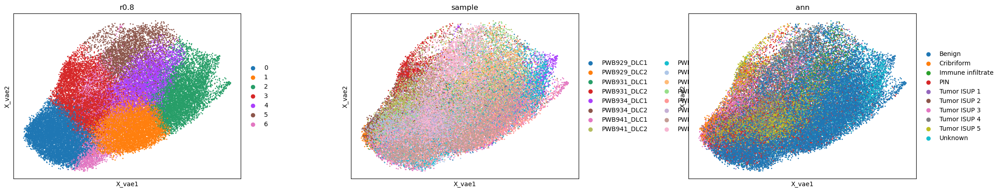

In [91]:
plot_embedding(model, adata, keys=["sample", "ann"], batch_keys=["sample"], train_params=train_params)

In [92]:
sc.tl.leiden(adata, key_added="clusters_vae_0.05")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


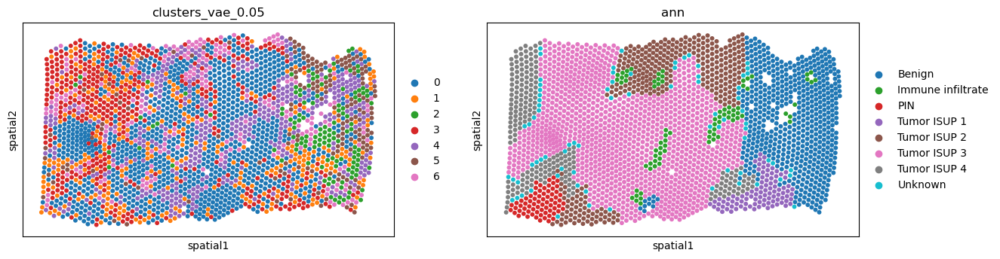

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


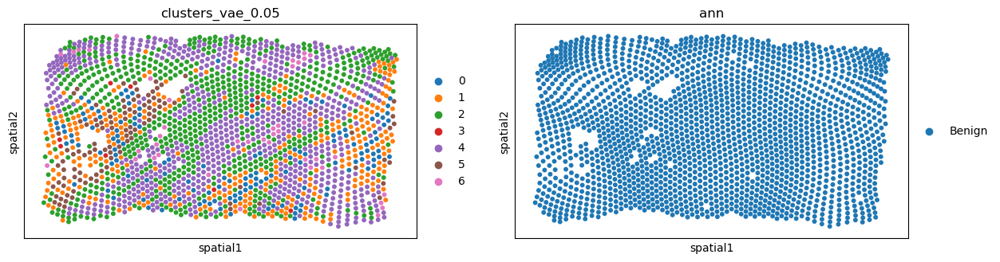

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


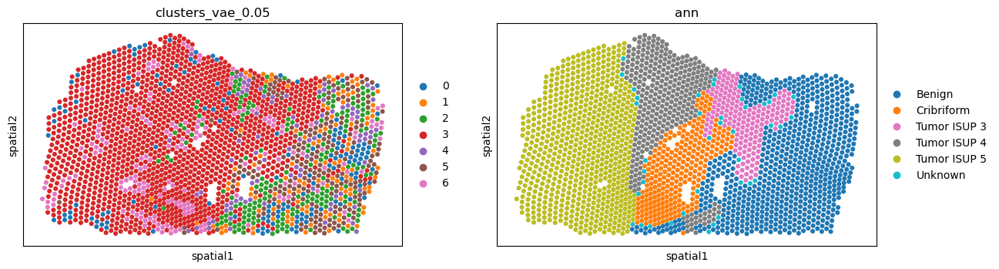

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


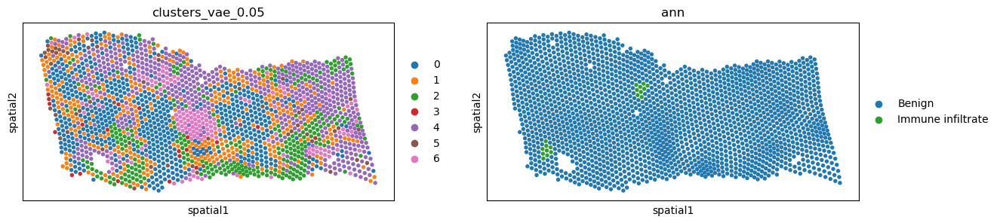

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


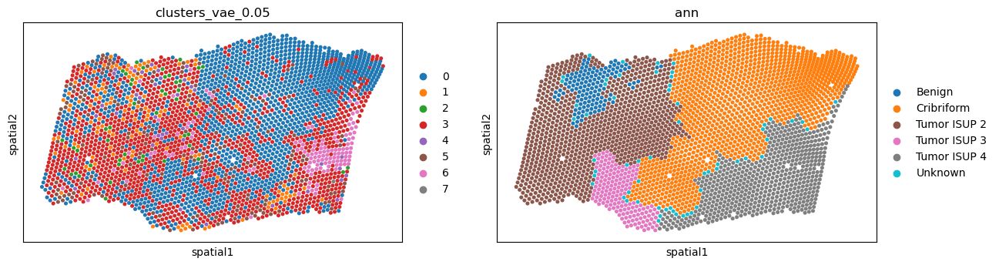

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


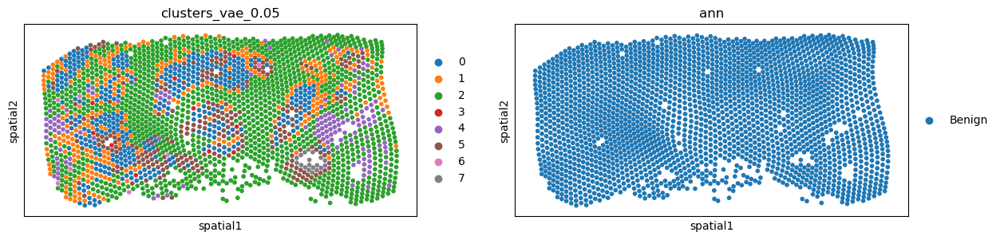

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


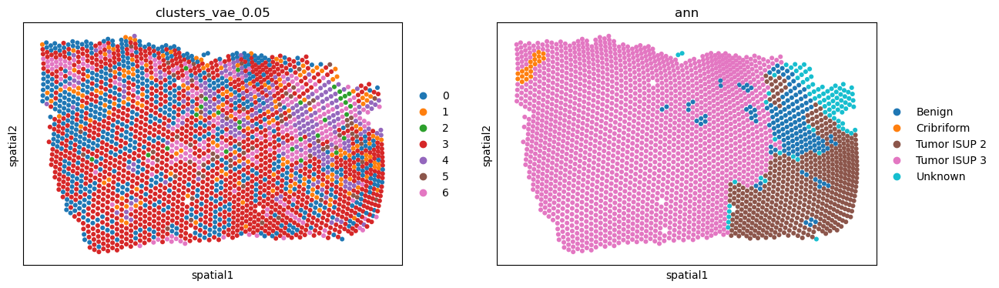

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


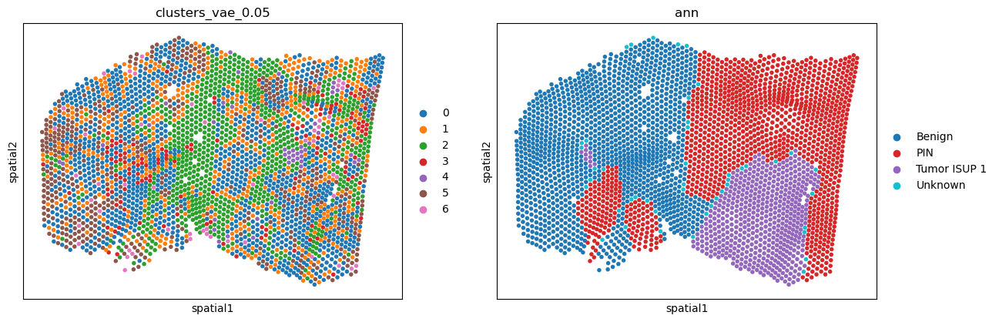

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


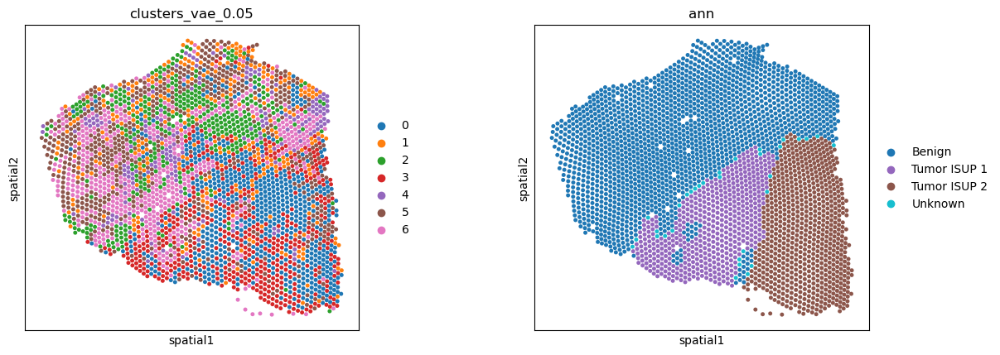

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


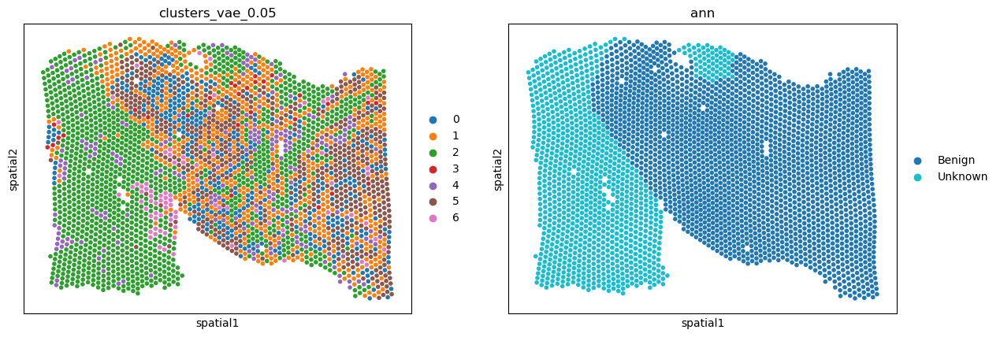

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


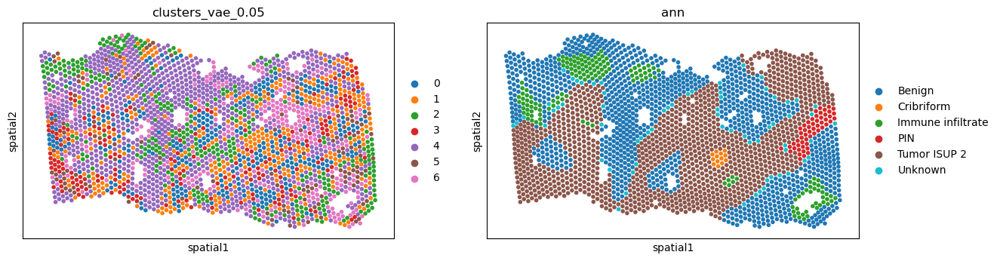

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


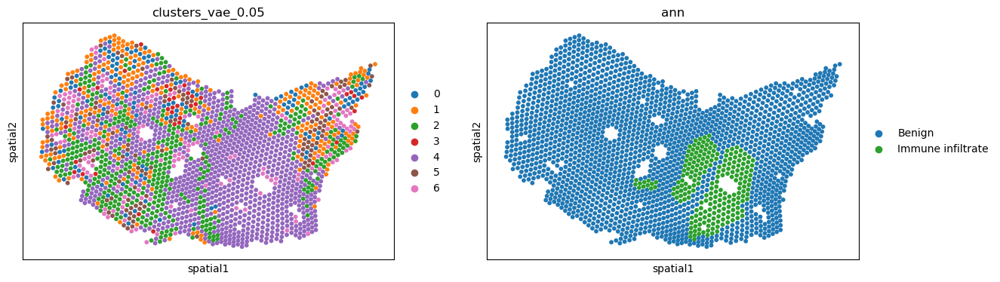

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


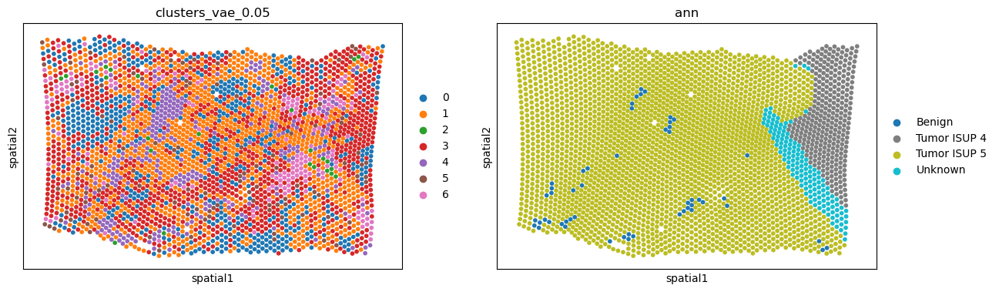

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


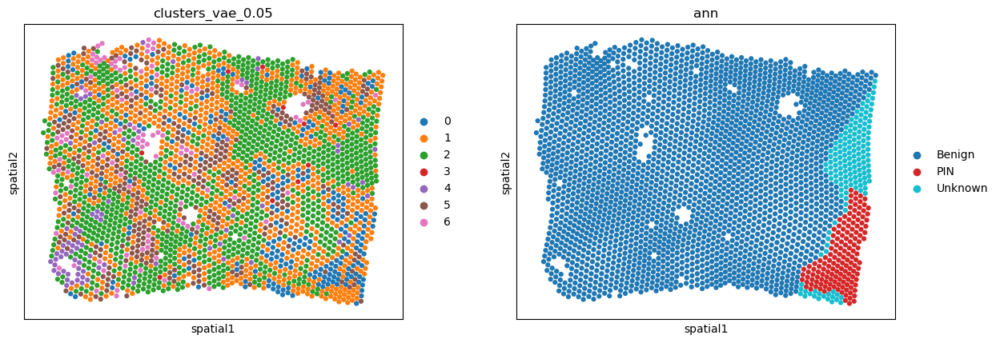

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


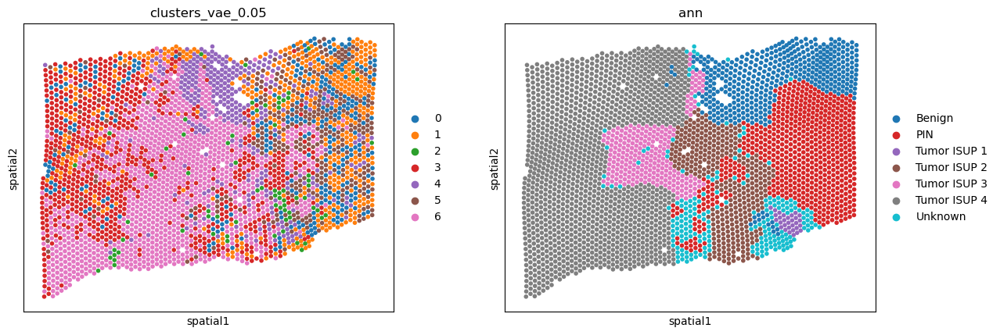

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


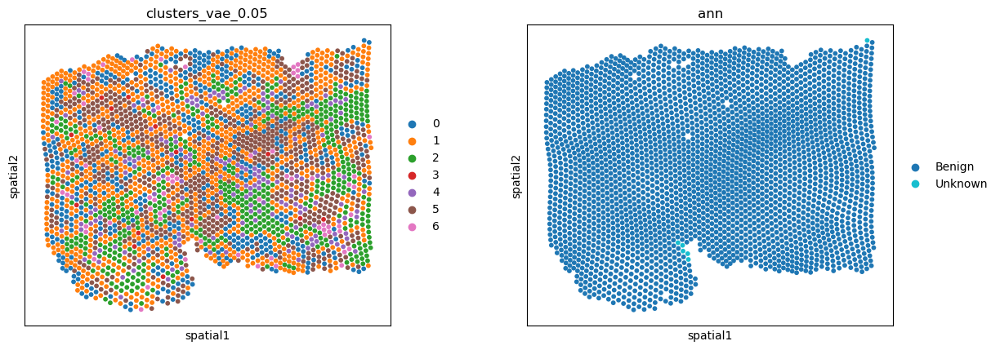

In [93]:
for s in adata.obs.loc[:,'sample'].unique():
    adata_sample = adata[adata.obs.loc[:,'sample']==s]
    sc.pl.spatial(adata_sample, spot_size=3, color=["clusters_vae_0.05", "ann"]) 

## Metrics

### Unintegrated

In [12]:
sc.tl.pca(adata)
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


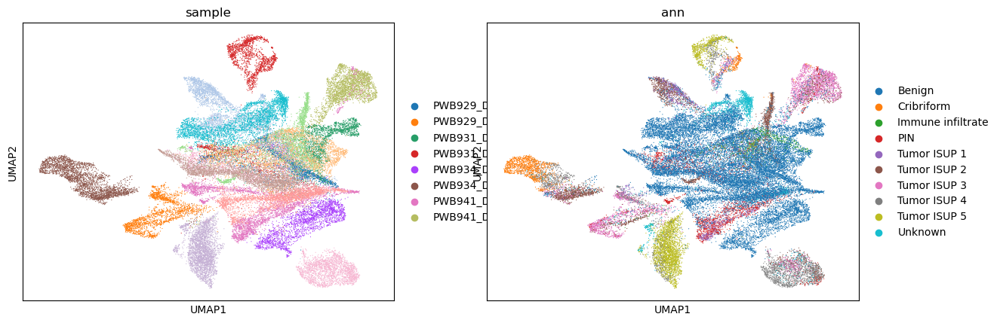

In [13]:
sc.pp.neighbors(adata, use_rep="Unintegrated", n_neighbors=30)
sc.tl.umap(adata)
sc.pl.umap(adata, color=["sample", "ann"])

### scVI

In [10]:
adata_scvi = sc.read("reports/scvi_prostate.h5ad")
adata_scvi

AnnData object with n_obs × n_vars = 42475 × 18950
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_counts', 'n_genes', 'size_factors', 'sample', 'type', 'patient', 'ann', 'tissue', 'imagerow', 'imagecol', '_scvi_batch', '_scvi_labels'
    uns: '_scvi_manager_uuid', '_scvi_uuid'
    obsm: 'scVI', 'spatial'
    layers: 'counts', 'scran_normalization', 'spotclean'

In [11]:
adata.obsm["scVI"] = adata_scvi.obsm["scVI"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


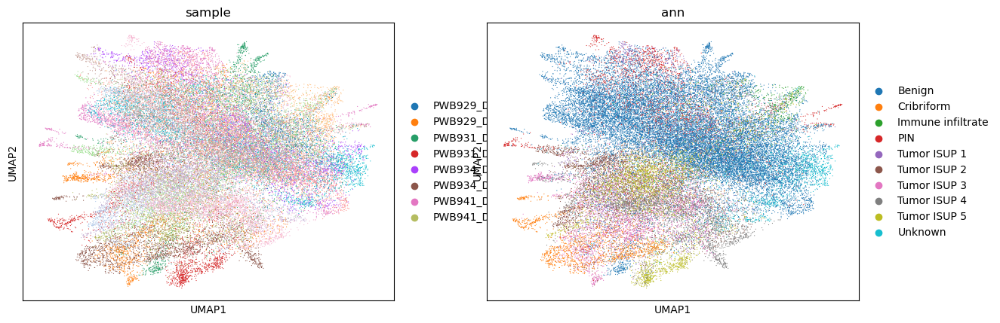

In [14]:
sc.pp.neighbors(adata, use_rep="scVI", n_neighbors=30)
sc.tl.umap(adata)
sc.pl.umap(adata, color=["sample", "ann"])

### Harmony

In [15]:
import scanpy.external as sce
sce.pp.harmony_integrate(adata, 'sample')

2023-04-21 18:19:48,688 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/threadpoolctl.py:762: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
2023-04-21 18:19:58,202 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-04-21 18:19:58,325 - harmonypy - INFO - Iteration 1 of 10
2023-04-21 18:20:07,821 - harmonypy - INFO - Iteration 2 of 10
2023-04-21 18:20:17,280 - harmonypy - INFO - Iteration 3 of 10
2023-04-21 18:20:26,773 - harmonypy - INFO - Iteration 4 of 1

In [17]:
adata.obsm["Harmony"] = adata.obsm["X_pca_harmony"]

### VAE

In [18]:
from src.types import TrainParams
from src.vae.model import VAE, ModelParams

train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate_0.01priv")

model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

model.load_state_dict(torch.load("mvae_params/prostate_0.01priv_20230420-233114.pt"))

<All keys matched successfully>

In [19]:
from src.vae.train import to_latent
emb = to_latent(model, adata, ["sample"], train_params)
adata.obsm["X_vae_0.01"] = np.vstack([x.numpy() for x in emb])

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:22<00:00, 15.06it/s]


In [22]:
model = VAE(adata, model_params)
model.load_state_dict(torch.load("mvae_params/prostate_0.3priv_20230420-163111.pt"))
emb = to_latent(model, adata, ["sample"], train_params)
adata.obsm["X_vae_0.3"] = np.vstack([x.numpy() for x in emb])

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:17<00:00, 18.62it/s]


In [ ]:
from scib_metrics.benchmark import Benchmarker
bm = Benchmarker(
    adata,
    batch_key="sample",
    label_key="ann",
    embedding_obsm_keys=["Unintegrated", "X_vae_0.01", "X_vae_0.3", "Harmony", "scVI"],
    n_jobs=16,
)
bm.benchmark()

Metrics:   0%|                                     | 0/10 [00:00<?, ?it/s, Bio conservation: isolated_labels]WARNING:jax._src.lib.xla_bridge:No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)

Metrics:  60%|██████████████████            | 6/10 [02:28<01:05, 16.39s/it, Batch correction: kbet_per_label]

In [ ]:
bm.plot_results_table(min_max_scale=False)